# Aprendemos de los conjuntos de datos

<br/><br/>

<img src="../figuras/data2.png" width="500">

<br/><br/>

+ Raschka, S., Liu, Y, Mirjalili, V. (2022). Machine Learning with PyTorch and Scikit-Learn. Develop machine learning and deep learning models with Python. Packt Publishing. Birmingham, UK. Pag. 3. `Making predictions about the future with supervised learning.`

<br/><br/>

<img src="../figuras/data1.png" width="500">

<br/><br/>

+ Kneusel, R.T. (2021). Practical Deep Learning - A Python-Based Introduction. First Edition. No Starch Press, Inc. San Francisco, USA. Pag. 69. `Training, Validation, and Test Data - The Three Subsets.`

<br/><br/>

<img src="../figuras/data3.png" width="600">

<br/><br/>

+ Zheng, A., Casari, A. (2018). Feature Engineering for Machine Learning. First Edition. O'Reilly Media, Inc. Sebastopol, CA, USA. Pag. 4. `The Machine Learning Pipeline.`

<br/><br/>

## Seleccionamos métodos y herramientas

+ `Label-Studio` 

> + `Label-Studio` es una herramienta que utilizamos para etiquetar datos. Permite entre otras cosas, el trabajo conjunto en tiempo real sobre imágenes, audios, textos y vídeos.

> + [Label-Studio](https://labelstud.io/)

> + Por ejemplo, podríamos analizar la siguiente observación acústica real:

In [1]:
from IPython.display import Audio

wav_dir = '/home/kasparov/Documentos/20190114_vpoblete/20221023_aumilab/JupyterBookUACh/audios/'

audio0 = wav_dir + "siren.wav"
Audio(audio0)

<br/><br/>

<img src="../figuras/sirena.png" width="750"/>

<br/><br/>

## `Programamos en lenguaje Python y usamos de librerías` 

+ Observemos audios reales:

In [2]:
audio1 = wav_dir + "alarm.wav"
Audio(audio1)

In [3]:
audio2 = wav_dir + "bird.wav"
Audio(audio2)

In [4]:
audio3 = wav_dir + "dog.wav"
Audio(audio3)

In [5]:
audio4 = wav_dir + "helicopter.wav"
Audio(audio4)

In [6]:
audio5 = wav_dir + "motorcycle.wav"
Audio(audio5)

In [7]:
audio6 = wav_dir + "music.wav"
Audio(audio6)

In [8]:
audio7 = wav_dir + "shout.wav"
Audio(audio7)

In [9]:
audio8 = wav_dir + "speech.wav"
Audio(audio8)

In [10]:
class Power:
    
    def __init__(self, name, wav_dir):
        self.name = name
        self.kind = ''
        self.duration = 0.0
        self.power = 0.0
        self.calculator(name, wav_dir)
        
    def calculator(self, audio, wav_dir):
        self.kind_set(audio)
        self.audio_average_power(wav_dir)
    
    def audio_average_power(self, wav_dir):
        
        wav_path = os.path.join(wav_dir, self.name)
        waveform, sample_rate = torchaudio.load(wav_path)
        num_channels, num_frames = waveform.shape
        
        if waveform.numpy().shape[1] != 0:
            
            ft_wf = np.fft.fft(waveform.numpy())/(math.sqrt(waveform.numpy().shape[1]))
            
            parseval_waveform = np.sum(waveform.numpy()**2)
            parseval_fourier_transform = np.sum(np.abs(ft_wf)**2)
            
            if (np.float32(round(parseval_waveform,1)) == np.float32(round(parseval_fourier_transform,1))):
                
                self.power = parseval_waveform
                
                duration = torch.arange(0, num_frames) / sample_rate
                self.duration = duration.numpy()[-1]
    
    def kind_set(self, audio):
        text = audio.split('.')
        self.kind = text[0]

In [11]:
import os
import torch
import torchaudio
import numpy as np
import math
import pandas as pd
import matplotlib.pyplot as plot

audio_class = []
audio_class.append(Power('alarm.wav', wav_dir))
audio_class.append(Power('bird.wav', wav_dir))
audio_class.append(Power('dog.wav', wav_dir))
audio_class.append(Power('helicopter.wav', wav_dir))
audio_class.append(Power('motorcycle.wav', wav_dir))
audio_class.append(Power('music.wav', wav_dir))
audio_class.append(Power('rain.wav', wav_dir))
audio_class.append(Power('shout.wav', wav_dir))
audio_class.append(Power('speech.wav', wav_dir))
audio_class.append(Power('wind.wav', wav_dir))

### Tabla

In [12]:
data = []
for i in range(len(audio_class)):
    
    data.append([audio_class[i].name, audio_class[i].kind, audio_class[i].duration, audio_class[i].power])

df = pd.DataFrame(data, columns = ['file name', 'event', 'duration', 'power'])
pd.set_option('display.float_format', '{:.0f}'.format)
df

,file name,event,duration,power
0,alarm.wav,alarm,60,36324
1,bird.wav,bird,31,133
2,dog.wav,dog,6,5737
3,helicopter.wav,helicopter,20,50644
4,motorcycle.wav,motorcycle,20,8359
5,music.wav,music,30,31215
6,rain.wav,rain,28,872
7,shout.wav,shout,10,9410
8,speech.wav,speech,15,4239
9,wind.wav,wind,38,15681


### Gráfico

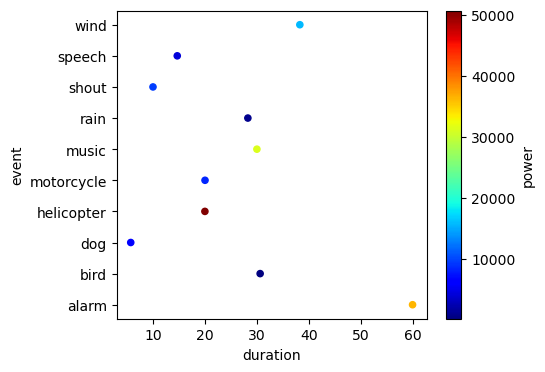

In [13]:
ax = df.plot.scatter(x='duration', y='event', c='power', colormap='jet', figsize=(5,4))